# Image Stitching using SIFT

Your phone can take a series of photos or a video and convert it into a panoramic image. I'm going to try and recreate that here in this notebook. I have this clean video of a beautiful landscape in Greece (courtesy of my brother-in-law), which I'll convert into a panorama using SIFT.

In [2]:
import cv2
import numpy as np
from anutils import data_path
from anutils.cv import rects, rect, homogenize, unhomogenize, homogenize_1d, unhomogenize_1d
from IPython import display as disp
from matplotlib import pyplot as plt
from itertools import accumulate
from operator import matmul, attrgetter
from functools import reduce
from tqdm.notebook import tqdm

# Configuration
fa, fb = figscale = (7, 2)
plt.rcParams['text.usetex'] = True
plt.rcParams['font.size'] = 20
plt.rcParams['figure.figsize'] = (4 * fa // fb, 3 * fa // fb)
plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['xtick.bottom'] = False
plt.rcParams['xtick.labelbottom'] = False
plt.rcParams['ytick.left'] = False
plt.rcParams['ytick.labelleft'] = False
np.set_printoptions(precision=2, suppress=True)

def disprgb(image):
    rgbim = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(rgbim)
    plt.show()

def disp_kps(image, keypoints):
    d_img = image.copy()
    cv2.drawKeypoints(d_img, keypoints, d_img)
    disprgb(d_img)

def disp_mtc(img1, kps1, img0, kps0, matches01):
    d_img = cv2.drawMatches(img1, kps1, img0, kps0, 
                            matches01, None, 
                            flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
    disprgb(d_img)
    

video_file = data_path / 'image-stitching-example.mp4'
frames_path = data_path / 'frames'

disp.Video(str(video_file), embed=True)

First off, we'll split the video into several individual frames that we can stitch together. We'll use ffmpeg to do this (so this notebook requires ffmpeg)

In [3]:
%%bash
dos2unix << 'EOF' > tmp.sh

# Variables
FRAMES_DIR=frames
EXTENSION=png
START_TIME=1.5
FRAME_RATE=1

# To data directory
pushd ../../data

# Reset frame directory
if [ -d $FRAMES_DIR ]; then
    rm -f $FRAMES_DIR/*
else
    mkdir $FRAMES_DIR
fi

# Extract frames from video
ffmpeg -i image-stitching-example.mp4 -ss $START_TIME -r 1 $FRAMES_DIR/image-stitching-example-%02d.$EXTENSION 2>&1

# Remove first frame
rm $FRAMES_DIR/image-stitching-example-01.$EXTENSION

popd
EOF
bash tmp.sh

/mnt/c/Users/akans/Documents/Projects/andys-notebook/data /mnt/c/Users/akans/Documents/Projects/andys-notebook/notebooks/image-processing-and-computer-vision
ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enabl

Next up let's read the first frame in

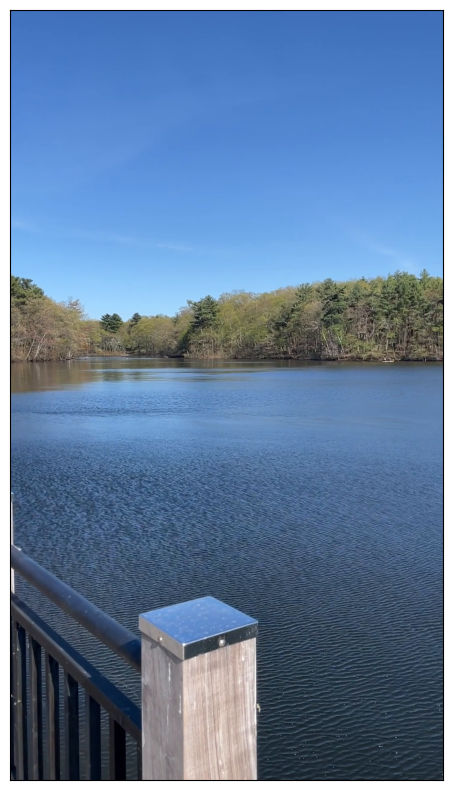

In [4]:
frames = sorted(list(frames_path.glob("*.png")))
first_frame = frames[0]
img0 = cv2.imread(str(first_frame))

disprgb(img0)

We'll then use SIFT to find some keypoints in this image.

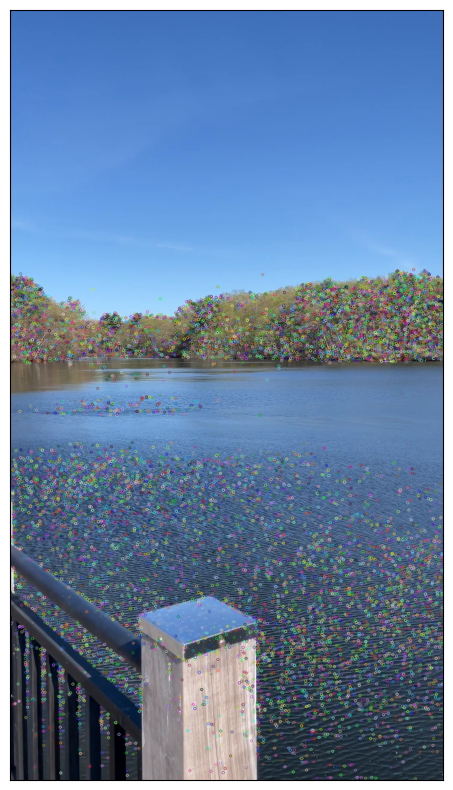

In [5]:
sift = cv2.SIFT.create()

kps0, dsc0 = sift.detectAndCompute(img0, None)

disp_kps(img0, kps0)

Next image! We'll do the same thing except we'll run SIFT for the entire image

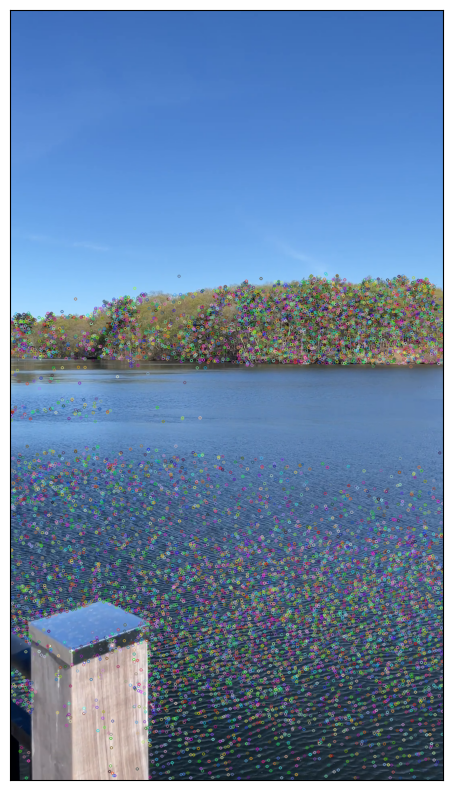

In [6]:
second_frame = frames[1]
img1 = cv2.imread(str(second_frame))

kps1, dsc1 = sift.detectAndCompute(img1, None)

disp_kps(img1, kps1)

Now we'll try to match

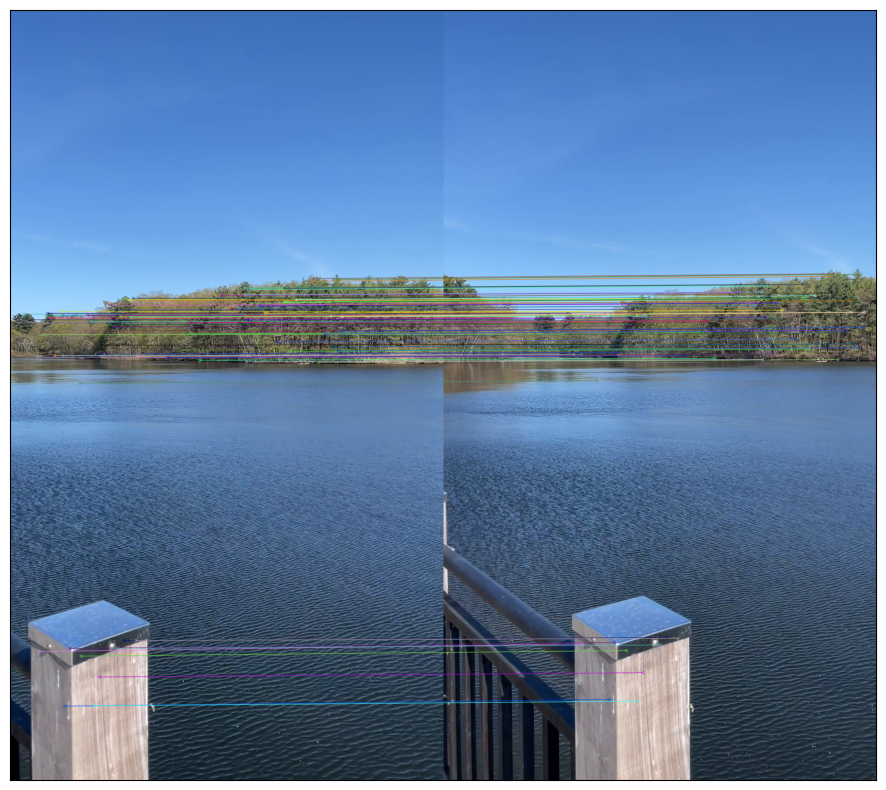

In [7]:
matcher = cv2.BFMatcher()

def match_with_ratio_test(trg_dsc, src_dsc, ratio_threshold=0.45):
    match_groups = matcher.knnMatch(trg_dsc, src_dsc, k=2)
    positive_b = [ m for m in match_groups if m[0].distance > 0 ]
    return [ a for a,b in positive_b if a.distance/b.distance < ratio_threshold ]

matches01 = match_with_ratio_test(dsc1, dsc0, 0.25)

disp_mtc(img1, kps1, img0, kps0, matches01)

From these matches, we can compute a perspective transformation (a homography) We'll use RANSAC and opencv's `findHomography` function

In [8]:
def homography_from_matches(matches, kps1, kps0, reprojThreshold=7.0):
    dst_points = np.array([ kps0[m.trainIdx].pt for m in matches ])
    src_points = np.array([ kps1[m.queryIdx].pt for m in matches ])
    M,_ = cv2.findHomography(src_points, dst_points, cv2.RANSAC, reprojThreshold)
    return M

M10 = homography_from_matches(matches01, kps1, kps0)
M10

array([[  0.9 ,  -0.01, 228.54],
       [ -0.08,   0.95,  36.44],
       [ -0.  ,  -0.  ,   1.  ]])

Finally, warp our new image and stitch it with our original one

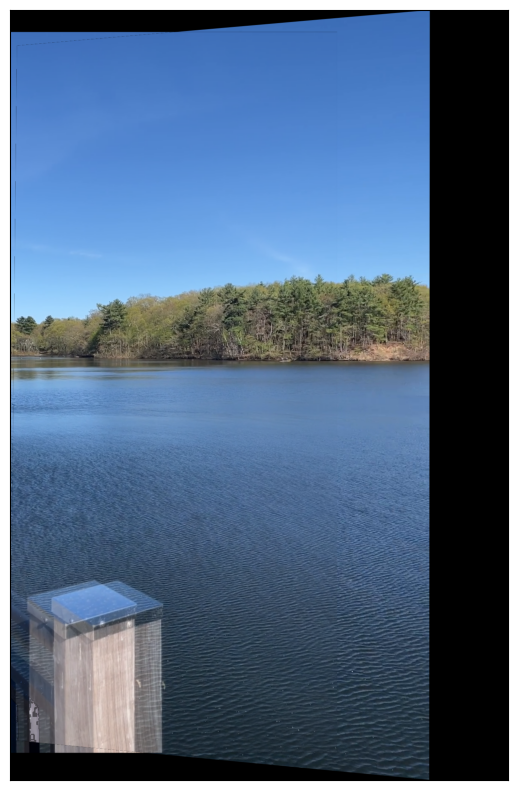

In [9]:
# == IMAGE TRANSFORMATION ==

def transform(points, M):
    h_points = homogenize(points)
    h_trns_points = M @ h_points
    trns_points = unhomogenize(h_trns_points)
    return trns_points

def translate(p):
    return np.array([
        [1,0,p[0]],
        [0,1,p[1]],
        [0,0,1]
    ])

# == BOUNDING BOX ==

def image_box(img):
    iy,ix = img.shape[:2]
    tl = np.array([0,0])
    br = np.array([ix,iy])
    return (tl, br)

def bounding_box(points):
    tl = points.min(axis=0)
    br = points.max(axis=0)
    return (tl, br)

def box_dimensions(tl, br):
    return np.ceil(br - tl).astype(np.int32)

# == COMBINING IMAGES TOGETHER ==

def intersects(a, b):
    return np.all((a > 0) & (b > 0), axis=2)

def union_box(box_1, box_2):
    tl1, br1 = box_1
    tl2, br2 = box_2
    tl_un = np.fmin(tl1, tl2)
    br_un = np.fmax(br1, br2)
    return (tl_un, br_un)

def union_image(img1, img0):
    rescale = np.ones(img1.shape[:2], np.uint8)
    rescale += np.where(intersects(img0, img1), np.uint8(1), np.uint8(0))
    rescale = rescale[:,:,np.newaxis]
    stitched = np.array([img0, img1], dtype=np.int16)
    return (stitched.sum(axis=0) // rescale).astype(np.uint8)

# == MAIN CODE ==

# Transform bounding box 
# to find new dimensions
# and the correction factor
iy1,ix1 = img1.shape[:2]
bnd_box1 = rect(ix1, iy1)
t_box1 = transform(bnd_box1, M10)
t_tl1, _ = t_bbox1 = bounding_box(t_box1)
T1 = translate(-t_tl1)

# Find dimensions of the union of both images
img_box0 = image_box(img0)
s_bbox10 = union_box(t_bbox1, img_box0)
s_dim10 = box_dimensions(*s_bbox10)

# Warp second image to match first.
# Also translate first to compensate for correction
t_img0 = cv2.warpPerspective(img0, T1, s_dim10)
t_img1 = cv2.warpPerspective(img1, T1 @ M10, s_dim10)
stitched10 = union_image(t_img1, t_img0)

disprgb(stitched10)

Now for the next frame, we need to attach the frame image to the previous image. However, in order to stitch the image to the full panorama, we need to make _two_ transformations: one to warp the third frame to match the second frame, and one to match the third and second frame to the first frame. So we'll figure out how to do this before we go do the full frame

Stitching::  33%|###3      | 1/3 [00:00<?, ?it/s]

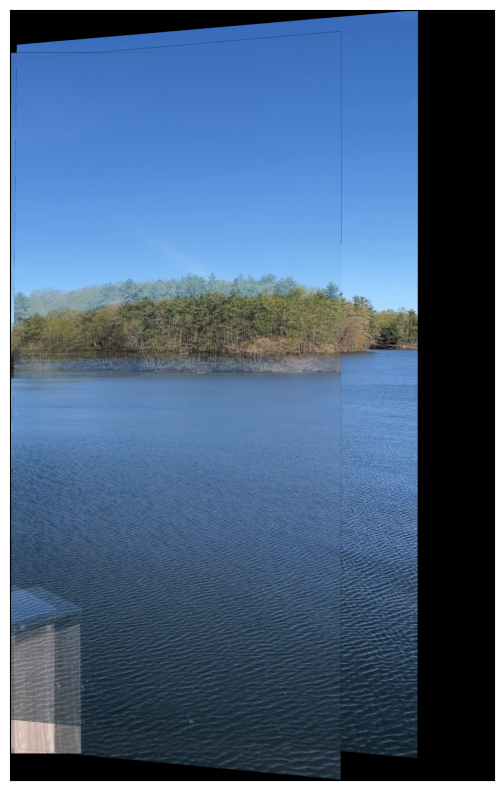

In [33]:
# Load third image
third_frame = frames[2]
img2 = cv2.imread(str(third_frame))

imgs = [img0, img1, img2]

def transform_and_stitch(imgs):
    stitched = imgs[0]
    for img in tqdm(imgs[1:], desc='Stitching:', total=len(imgs), initial=1):
        kpsS, dscS = sift.detectAndCompute(stitched, None)
        kpsI, dscI = sift.detectAndCompute(img, None)
        matches = match_with_ratio_test(dscI, dscS)
        M = homography_from_matches(matches, kpsI, kpsS)

        # Transform bounding box of new image 
        # Find new dimensions and the correction factor
        iyI,ixI = img.shape[:2]
        bnd_boxI = rect(ixI, iyI)
        t_boxI = transform(bnd_boxI, M10)
        t_tlI, _ = t_bboxI = bounding_box(t_boxI)
        T = translate(-t_tlI)
        
        # Find dimensions of the union of both images
        img_boxS = image_box(stitched)
        s_bboxS = union_box(t_bboxI, img_boxS)
        s_dimS = box_dimensions(*s_bboxS)
        
        # Warp second image to match first.
        # Also translate first to compensate for correction
        t_stitched = cv2.warpPerspective(stitched, T1, s_dimS)
        t_img = cv2.warpPerspective(img, T1 @ M10, s_dimS)
        stitched = union_image(t_img, t_stitched)

    # Return stitched image
    return stitched

stitched = transform_and_stitch(imgs)
disprgb(stitched)

Okay... So I realized I missed something incredibly important... These images are taken by a stationary camera thats _rotating_. So each of these perspectives are not going to be the same viewing angle... I didn't account for this and, as such, the perspective transformations had warped beyond my computers ability to comprehend their dimensions (leading to the crashes I was experiencing). I have to first transform these images before stitching them...

I need to perform a cylindrical transformation on these images. So I'll first try doing that on one

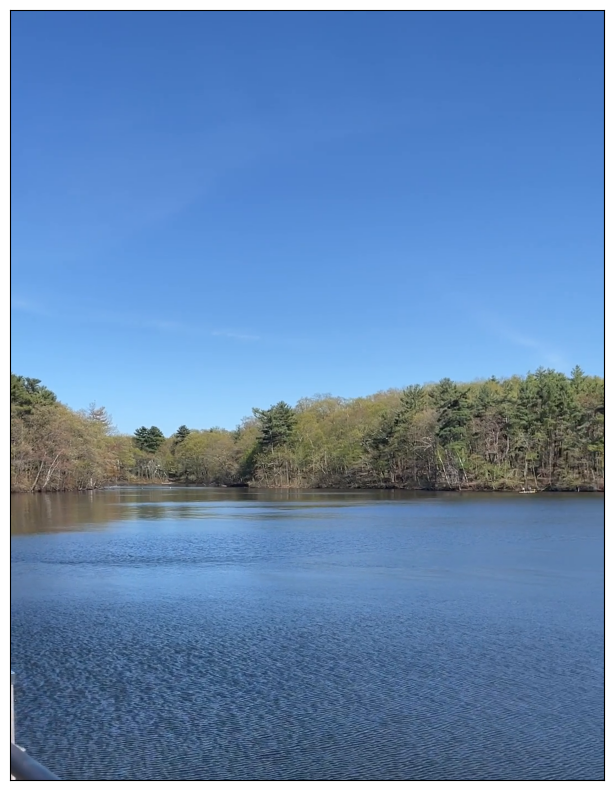

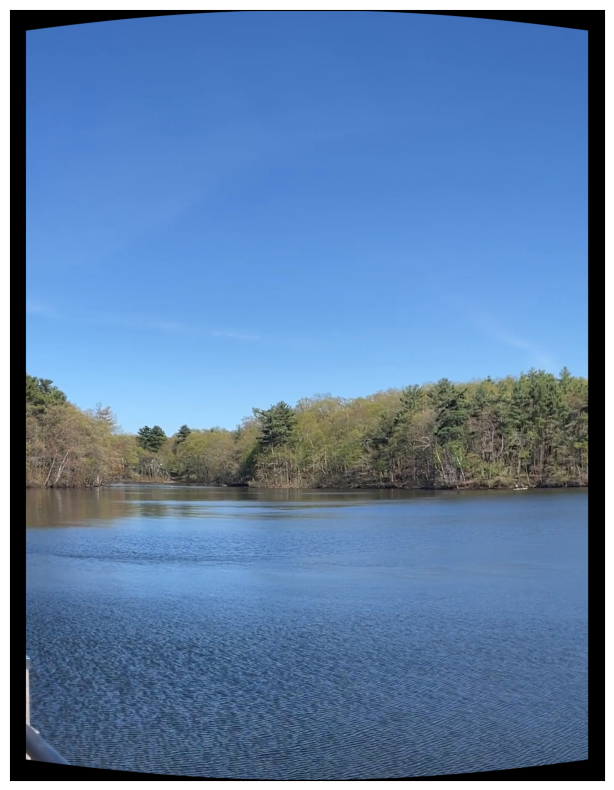

In [34]:
frames = sorted(list(frames_path.glob("*.png")))

# Crop frames
crop_y = 1400

# I asked ChatGPT if I could copy her homework...
# She said it's okay as long as I change it around a bit
# to make it look like my own work \-.-/

def stitch_images(imgs):
    # Generate pairs indeces
    idx = np.arange(len(imgs))
    pairs = np.hstack((idx[:-1,np.newaxis], idx[1:,np.newaxis]))
    
    # Compute keypoints
    kpdscs = [ sift.detectAndCompute(img, None) for img in imgs ]
    
    # Compute homographies for images
    mats = []
    for iA,iB in pairs:
        kpsB, dscB = kpdscs[iB]
        kpsA, dscA = kpdscs[iA]
        matches = match_with_ratio_test(dscB, dscA)
        matBA = homography_from_matches(matches, kpsB, kpsA, 8.0)
        mats.append(matBA)
    
    # Stitch them together ?
    return transform_and_stitch(imgs, mats)


def to_cylinder_transformation(img, focal_length=1500):
    """"""
    iy, ix = img.shape[:2]
    o_x = ix/2
    o_y = iy/2

    x,y = np.meshgrid(np.arange(ix), np.arange(iy))

    # Normalize x to -1. to 1.
    n_x = (x - o_x) / focal_length
    n_y = (y - o_y) / focal_length

    # To cylinder coordinates
    r = np.sqrt(n_x**2 + 1)
    c_x = n_x * r
    c_y = n_y * r

    # Remap to image space
    map_x = (focal_length * c_x + o_x).astype(np.float32)
    map_y = (focal_length * c_y + o_y).astype(np.float32)

    # Get new image dimensions
    min_x = np.min(map_x)
    min_y = np.min(map_y)
    max_x = np.max(map_x)
    max_y = np.max(map_y)

    # Remap image
    remapped = cv2.remap(img, map_x, map_y, cv2.INTER_LINEAR)

    # Resize to fit new dimensions
    return remapped

planar_file = frames[0]
planar_img = cv2.imread(str(planar_file))
planar_img = planar_img[:crop_y,:,:]
cylinder_img = to_cylinder_transformation(planar_img)
disprgb(planar_img)
disprgb(cylinder_img)

Let's see if these transformed images fare better....

Stitching::  33%|###3      | 1/3 [00:00<?, ?it/s]

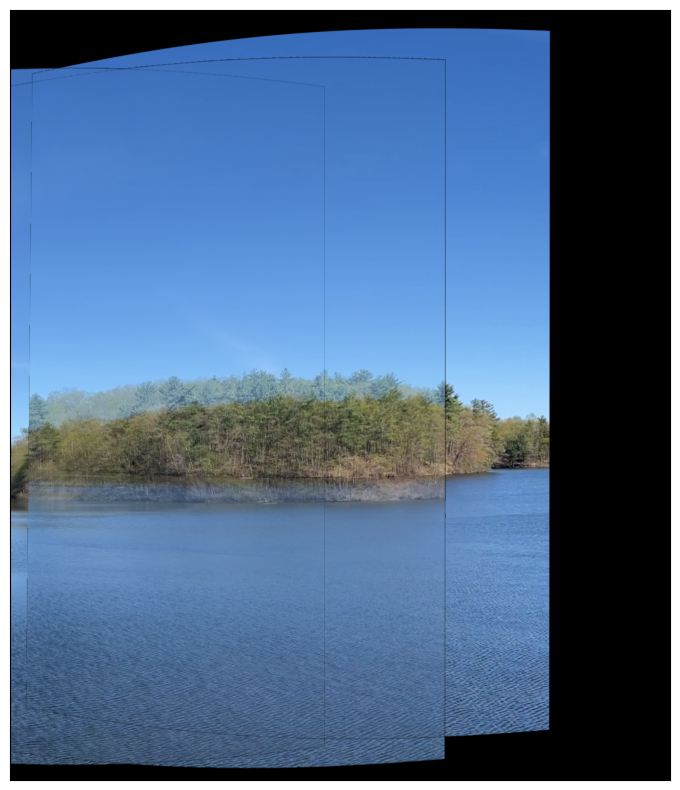

In [37]:
planar_files = frames[0:3]
planar_imgs  = [cv2.imread(f) for f in planar_files]
planar_imgs  = [planar_img[:crop_y,:,:] for planar_img in planar_imgs ]
cylinder_imgs = [to_cylinder_transformation(planar_img) for planar_img in planar_imgs ]
stitched = transform_and_stitch(cylinder_imgs)
disprgb(stitched)